<a href="https://colab.research.google.com/github/RamyaThallapaka/Forest-Fire-Detection-Using-Recurrent-Convolutional-Neural-Networks-RCNN-and-Deep-Learning/blob/main/Forest_Fire_Detection_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install catboost
!pip install dask[dataframe]


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.7/98.7 MB 10.1 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of dask-expr to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 243.2/243.2 kB 6.5 MB/s eta 0:00:00


In [ ]:
#GENERAL
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
#PATH PROCESS
import os
import os.path
from pathlib import Path
import glob
#IMAGE PROCESS
from PIL import Image
from keras.preprocessing import image
from tensorflow.keras.applications import EfficientNetB0, NASNetMobile
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import cv2
from keras.applications.vgg16 import preprocess_input, decode_predictions
#SCALER & TRANSFORMATION

from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Dropout
from tensorflow.keras.optimizers import Adam

from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from keras import regularizers
from sklearn.preprocessing import LabelEncoder
#ACCURACY CONTROL
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report, roc_auc_score, roc_curve
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score
#OPTIMIZER
from keras.optimizers import RMSprop,Adam,Optimizer,Optimizer
#MODEL LAYERS
from tensorflow.keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPool2D, BatchNormalization,MaxPooling2D,BatchNormalization,\
                        Permute, TimeDistributed, Bidirectional,GRU, SimpleRNN, LSTM, GlobalAveragePooling2D, SeparableConv2D
from keras import models
from keras import layers
import tensorflow as tf
from tensorflow import keras
from keras.applications import VGG16,VGG19,inception_v3
from keras import backend as K
from keras.utils import plot_model
#SKLEARN CLASSIFIER
from xgboost import XGBClassifier, XGBRegressor
from lightgbm import LGBMClassifier, LGBMRegressor
from catboost import CatBoostClassifier, CatBoostRegressor
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.ensemble import GradientBoostingClassifier, GradientBoostingRegressor
from sklearn.ensemble import BaggingRegressor
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor
from sklearn.neural_network import MLPClassifier, MLPRegressor
from sklearn.neighbors import KNeighborsClassifier, KNeighborsRegressor
from sklearn.linear_model import LinearRegression
from sklearn.cross_decomposition import PLSRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import RidgeCV
from sklearn.linear_model import Lasso
from sklearn.linear_model import LassoCV
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import ElasticNetCV
#IGNORING WARNINGS
from warnings import filterwarnings
filterwarnings("ignore",category=DeprecationWarning)
filterwarnings("ignore", category=FutureWarning)
filterwarnings("ignore", category=UserWarning)

In [ ]:
Fire_Dataset_Path = Path("/content/drive/My Drive/fire_dataset")

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
PNG_Path = list(Fire_Dataset_Path.glob(r"*/*.png"))

In [ ]:
PNG_Labels = list(map(lambda x: os.path.split(os.path.split(x)[0])[1],PNG_Path))

In [ ]:
print("FIRE: ", PNG_Labels.count("fire_images"))
print("NO_FIRE: ", PNG_Labels.count("non_fire_images"))

FIRE:  755
NO_FIRE:  244


In [ ]:
PNG_Path_Series = pd.Series(PNG_Path,name="PNG").astype(str)
PNG_Labels_Series = pd.Series(PNG_Labels,name="CATEGORY")

In [ ]:
print(PNG_Path_Series)

0      /content/drive/My Drive/fire_dataset/non_fire_...
1      /content/drive/My Drive/fire_dataset/non_fire_...
2      /content/drive/My Drive/fire_dataset/non_fire_...
3      /content/drive/My Drive/fire_dataset/non_fire_...
4      /content/drive/My Drive/fire_dataset/non_fire_...
                             ...                        
994    /content/drive/My Drive/fire_dataset/fire_imag...
995    /content/drive/My Drive/fire_dataset/fire_imag...
996    /content/drive/My Drive/fire_dataset/fire_imag...
997    /content/drive/My Drive/fire_dataset/fire_imag...
998    /content/drive/My Drive/fire_dataset/fire_imag...
Name: PNG, Length: 999, dtype: object


In [ ]:
print(PNG_Labels_Series)

0      non_fire_images
1      non_fire_images
2      non_fire_images
3      non_fire_images
4      non_fire_images
            ...       
994        fire_images
995        fire_images
996        fire_images
997        fire_images
998        fire_images
Name: CATEGORY, Length: 999, dtype: object


In [ ]:
PNG_Labels_Series.replace({"non_fire_images":"NO_FIRE","fire_images":"FIRE"},inplace=True)

In [ ]:
print(PNG_Labels_Series)

0      NO_FIRE
1      NO_FIRE
2      NO_FIRE
3      NO_FIRE
4      NO_FIRE
        ...   
994       FIRE
995       FIRE
996       FIRE
997       FIRE
998       FIRE
Name: CATEGORY, Length: 999, dtype: object


In [ ]:
Main_Train_Data = pd.concat([PNG_Path_Series,PNG_Labels_Series],axis=1)

In [ ]:
print(Main_Train_Data.head(-1))

                                                   PNG CATEGORY
0    /content/drive/My Drive/fire_dataset/non_fire_...  NO_FIRE
1    /content/drive/My Drive/fire_dataset/non_fire_...  NO_FIRE
2    /content/drive/My Drive/fire_dataset/non_fire_...  NO_FIRE
3    /content/drive/My Drive/fire_dataset/non_fire_...  NO_FIRE
4    /content/drive/My Drive/fire_dataset/non_fire_...  NO_FIRE
..                                                 ...      ...
993  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
994  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
995  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
996  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
997  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE

[998 rows x 2 columns]


In [ ]:
Main_Train_Data = Main_Train_Data.sample(frac=1).reset_index(drop=True)

In [ ]:
print(Main_Train_Data.head(-1))

                                                   PNG CATEGORY
0    /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
1    /content/drive/My Drive/fire_dataset/non_fire_...  NO_FIRE
2    /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
3    /content/drive/My Drive/fire_dataset/non_fire_...  NO_FIRE
4    /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
..                                                 ...      ...
993  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
994  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
995  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
996  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
997  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE

[998 rows x 2 columns]


In [ ]:
print(Main_Train_Data["PNG"][2])
print(Main_Train_Data["CATEGORY"][2])
print(Main_Train_Data["PNG"][200])
print(Main_Train_Data["CATEGORY"][200])
print(Main_Train_Data["PNG"][45])
print(Main_Train_Data["CATEGORY"][45])
print(Main_Train_Data["PNG"][852])
print(Main_Train_Data["CATEGORY"][852])

/content/drive/My Drive/fire_dataset/fire_images/fire.661.png
FIRE
/content/drive/My Drive/fire_dataset/fire_images/fire.677.png
FIRE
/content/drive/My Drive/fire_dataset/fire_images/fire.164.png
FIRE
/content/drive/My Drive/fire_dataset/fire_images/fire.463.png
FIRE


In [ ]:
remove_PNG = '../input/fire-dataset/fire_dataset/non_fire_images/non_fire.189.png'
Main_Train_Data = Main_Train_Data.loc[~(Main_Train_Data.loc[:,'PNG'] == remove_PNG),:]

In [ ]:
print(Main_Train_Data.loc[Main_Train_Data.loc[:,'PNG'] == remove_PNG,:])

Empty DataFrame
Columns: [PNG, CATEGORY]
Index: []


In [ ]:
print(Main_Train_Data.head(-1))

                                                   PNG CATEGORY
0    /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
1    /content/drive/My Drive/fire_dataset/non_fire_...  NO_FIRE
2    /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
3    /content/drive/My Drive/fire_dataset/non_fire_...  NO_FIRE
4    /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
..                                                 ...      ...
993  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
994  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
995  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
996  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
997  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE

[998 rows x 2 columns]


In [ ]:
plt.style.use("dark_background")

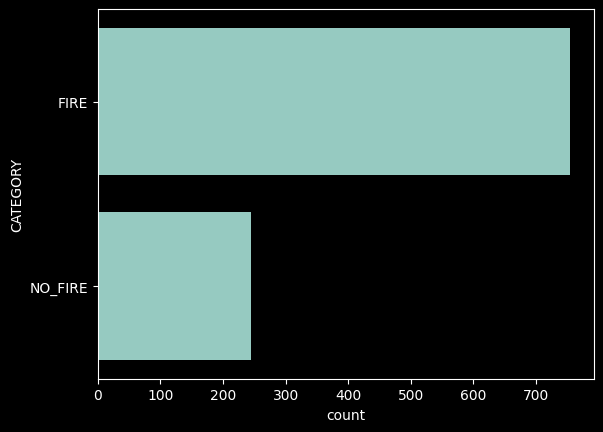

In [ ]:
sns.countplot(Main_Train_Data["CATEGORY"])
plt.show()

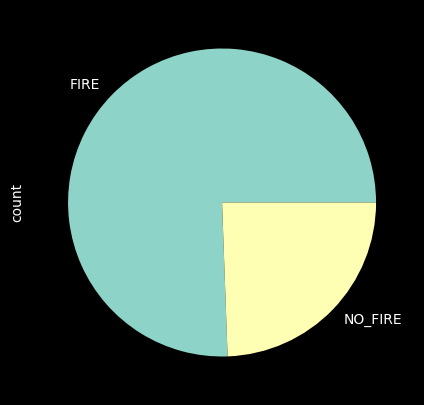

In [ ]:
Main_Train_Data['CATEGORY'].value_counts().plot.pie(figsize=(5,5))
plt.show()

Text(0.5, 1.0, 'FIRE')

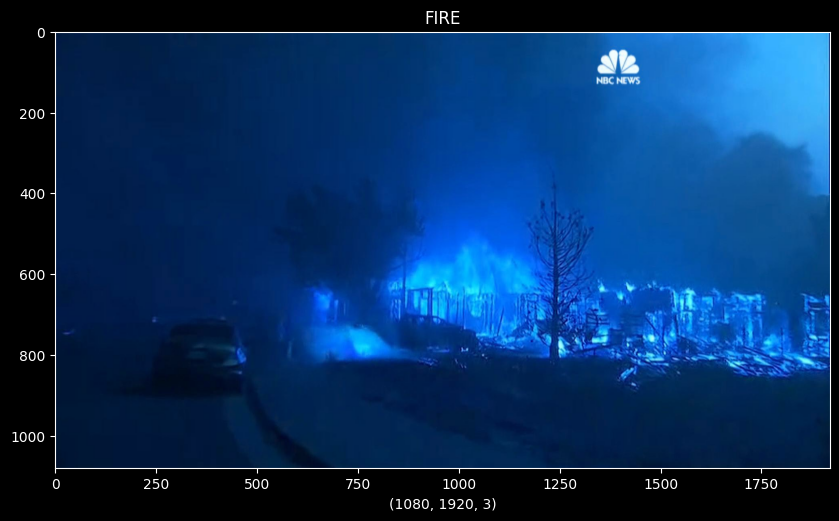

In [ ]:
figure = plt.figure(figsize=(10,10))
x = cv2.imread(Main_Train_Data["PNG"][0])
plt.imshow(x)
plt.xlabel(x.shape)
plt.title(Main_Train_Data["CATEGORY"][0])

Text(0.5, 1.0, 'FIRE')

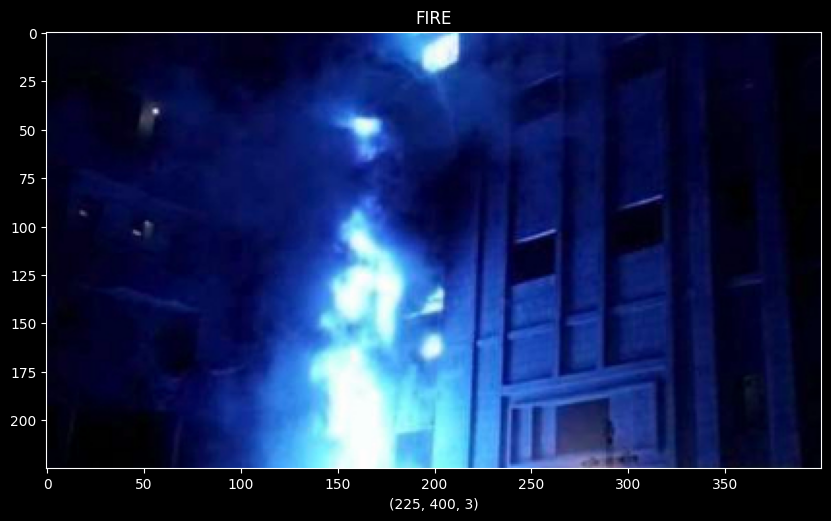

In [ ]:
figure = plt.figure(figsize=(10,10))
x = cv2.imread(Main_Train_Data["PNG"][993])
plt.imshow(x)
plt.xlabel(x.shape)
plt.title(Main_Train_Data["CATEGORY"][993])

Text(0.5, 1.0, 'FIRE')

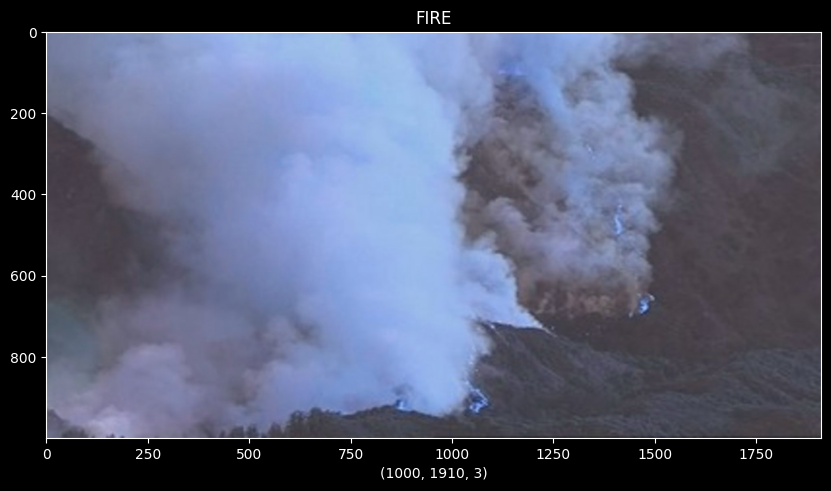

In [ ]:
figure = plt.figure(figsize=(10,10))
x = cv2.imread(Main_Train_Data["PNG"][20])
plt.imshow(x)
plt.xlabel(x.shape)
plt.title(Main_Train_Data["CATEGORY"][20])

Text(0.5, 1.0, 'FIRE')

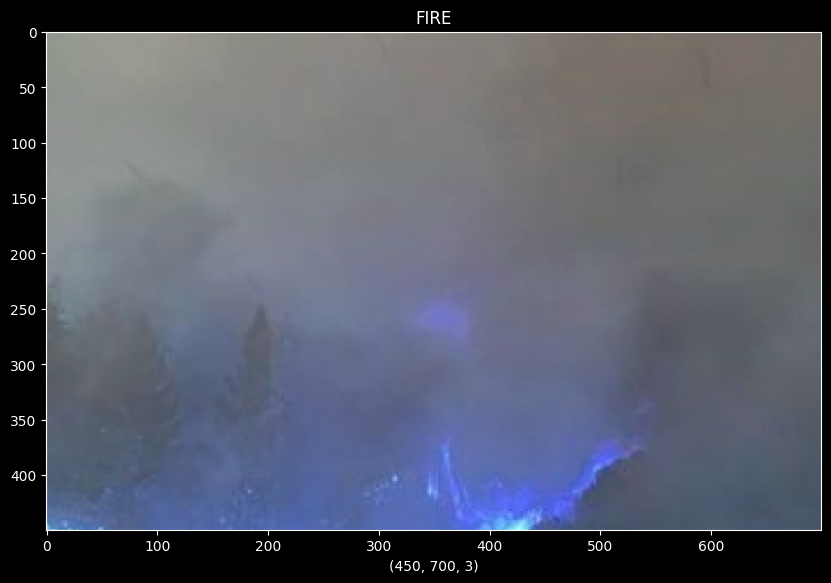

In [ ]:
figure = plt.figure(figsize=(10,10))
x = cv2.imread(Main_Train_Data["PNG"][48])
plt.imshow(x)
plt.xlabel(x.shape)
plt.title(Main_Train_Data["CATEGORY"][48])

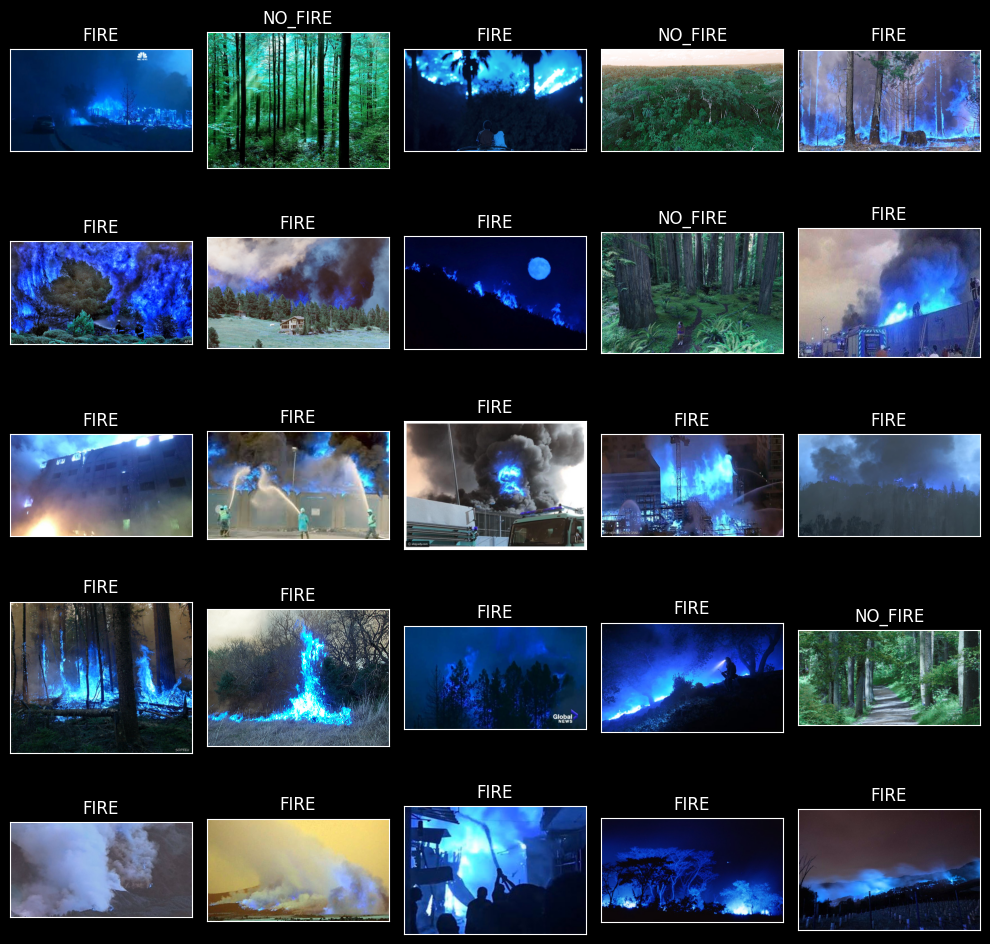

In [ ]:
fig, axes = plt.subplots(nrows=5,
                        ncols=5,
                        figsize=(10,10),
                        subplot_kw={"xticks":[],"yticks":[]})

for i,ax in enumerate(axes.flat):
    ax.imshow(cv2.imread(Main_Train_Data["PNG"][i]))
    ax.set_title(Main_Train_Data["CATEGORY"][i])
plt.tight_layout()
plt.show()

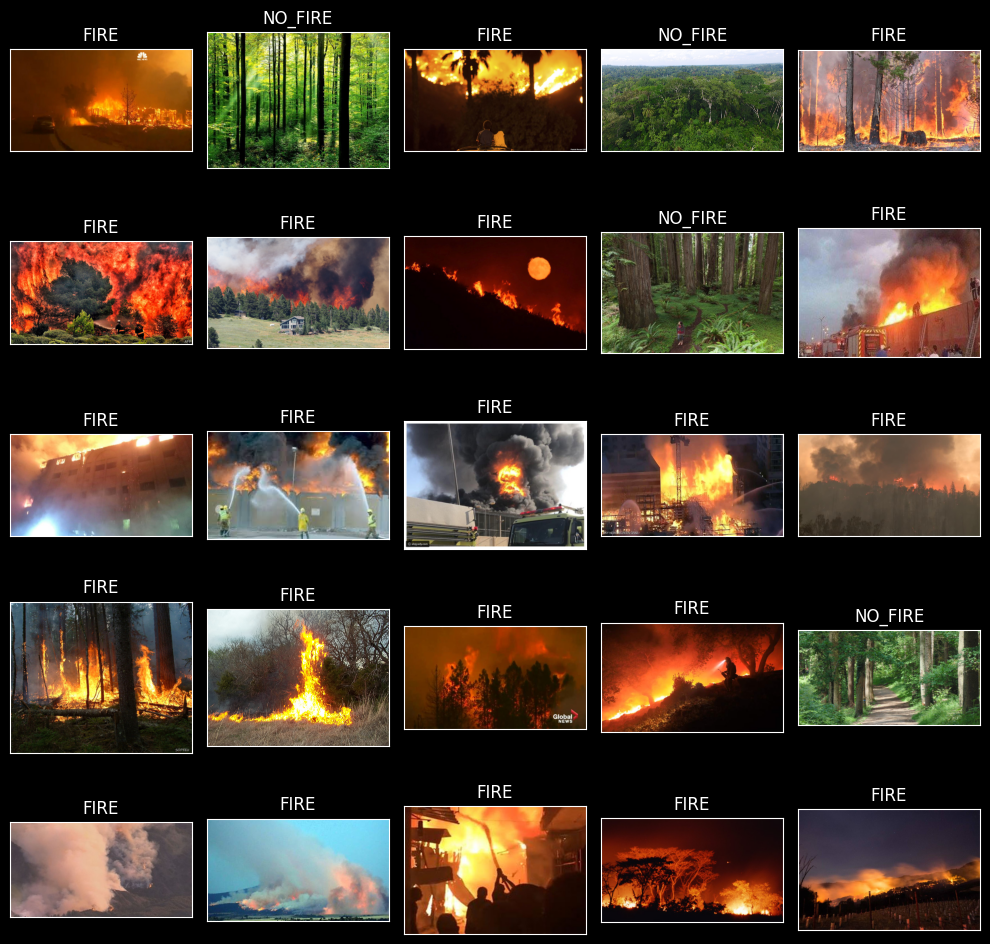

In [ ]:
fig, axes = plt.subplots(nrows=5,
                        ncols=5,
                        figsize=(10,10),
                        subplot_kw={"xticks":[],"yticks":[]})

for i,ax in enumerate(axes.flat):
    x = cv2.imread(Main_Train_Data["PNG"][i])
    x = cv2.cvtColor(x,cv2.COLOR_RGB2BGR)
    ax.imshow(x)
    ax.set_title(Main_Train_Data["CATEGORY"][i])
plt.tight_layout()
plt.show()

In [ ]:
Train_Generator = ImageDataGenerator(rescale=1./255,
                                    shear_range=0.3,
                                    zoom_range=0.2,
                                    brightness_range=[0.2,0.9],
                                    rotation_range=30,
                                    horizontal_flip=True,
                                    vertical_flip=True,
                                    fill_mode="nearest",
                                    validation_split=0.1)

In [ ]:
Test_Generator = ImageDataGenerator(rescale=1./255)

In [ ]:
Train_Data,Test_Data = train_test_split(Main_Train_Data,train_size=0.9,random_state=42,shuffle=True)

In [ ]:
print("TRAIN SHAPE: ",Train_Data.shape)
print("TEST SHAPE: ",Test_Data.shape)

TRAIN SHAPE:  (899, 2)
TEST SHAPE:  (100, 2)


In [ ]:
print(Train_Data.head(-1))
print("----"*20)
print(Test_Data.head(-1))

                                                   PNG CATEGORY
599  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
432  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
221  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
973  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
525  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
..                                                 ...      ...
71   /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
106  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
270  /content/drive/My Drive/fire_dataset/non_fire_...  NO_FIRE
860  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE
435  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE

[898 rows x 2 columns]
--------------------------------------------------------------------------------
                                                   PNG CATEGORY
453  /content/drive/My Drive/fire_dataset/fire_imag...     FIRE

In [ ]:
print(Test_Data["CATEGORY"].value_counts())

CATEGORY
FIRE       77
NO_FIRE    23
Name: count, dtype: int64


In [ ]:
encode = LabelEncoder()

In [ ]:
For_Prediction_Class = encode.fit_transform(Test_Data["CATEGORY"])

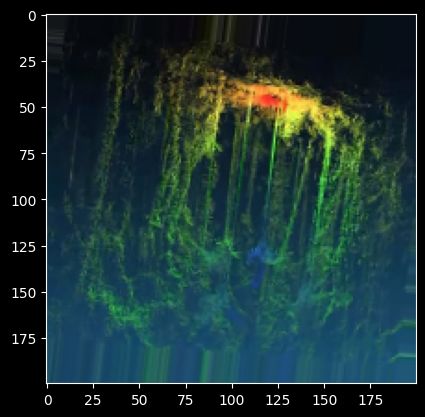

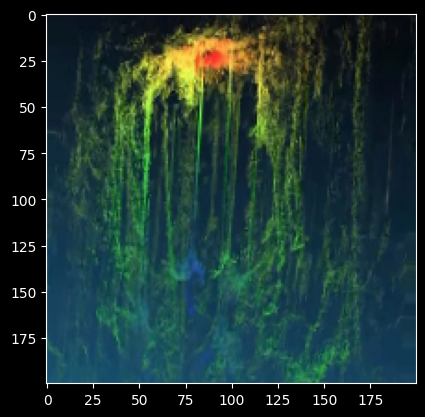

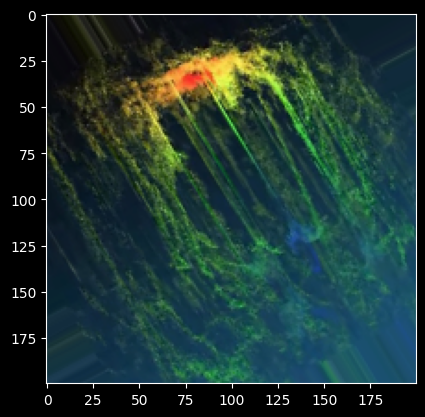

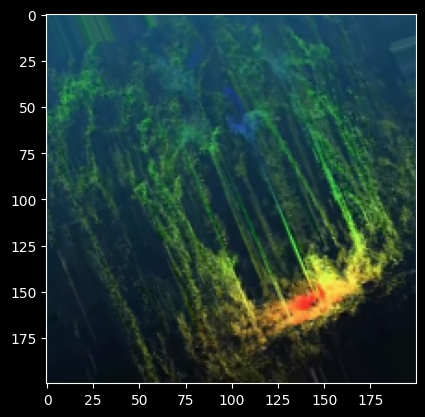

In [ ]:
example_Image = Train_Data["PNG"][99]
Load_Image = image.load_img(example_Image,target_size=(200,200))
Array_Image = image.img_to_array(Load_Image)
Array_Image = Array_Image.reshape((1,) + Array_Image.shape)

i = 0
for batch in Train_Generator.flow(Array_Image,batch_size=1):
    plt.figure(i)
    IMG = plt.imshow(image.array_to_img(batch[0]))
    i += 1
    if i % 4 == 0:
        break
plt.show()

In [ ]:
Train_IMG_Set = Train_Generator.flow_from_dataframe(dataframe=Train_Data,
                                                   x_col="PNG",
                                                   y_col="CATEGORY",
                                                   color_mode="rgb",
                                                   class_mode="categorical",
                                                   batch_size=32,
                                                   subset="training")

Found 810 validated image filenames belonging to 2 classes.


In [ ]:
Validation_IMG_Set = Train_Generator.flow_from_dataframe(dataframe=Train_Data,
                                                   x_col="PNG",
                                                   y_col="CATEGORY",
                                                   color_mode="rgb",
                                                   class_mode="categorical",
                                                   batch_size=32,
                                                   subset="validation")

Found 89 validated image filenames belonging to 2 classes.


In [ ]:
Test_IMG_Set = Test_Generator.flow_from_dataframe(dataframe=Test_Data,
                                                 x_col="PNG",
                                                 y_col="CATEGORY",
                                                 color_mode="rgb",
                                                 class_mode="categorical",
                                                 batch_size=32)

Found 100 validated image filenames belonging to 2 classes.


In [ ]:
for data_batch,label_batch in Train_IMG_Set:
    print("DATA SHAPE: ",data_batch.shape)
    print("LABEL SHAPE: ",label_batch.shape)
    break

DATA SHAPE:  (32, 256, 256, 3)
LABEL SHAPE:  (32, 2)


In [ ]:
for data_batch,label_batch in Validation_IMG_Set:
    print("DATA SHAPE: ",data_batch.shape)
    print("LABEL SHAPE: ",label_batch.shape)
    break

DATA SHAPE:  (32, 256, 256, 3)
LABEL SHAPE:  (32, 2)


In [ ]:
for data_batch,label_batch in Test_IMG_Set:
    print("DATA SHAPE: ",data_batch.shape)
    print("LABEL SHAPE: ",label_batch.shape)
    break

DATA SHAPE:  (32, 256, 256, 3)
LABEL SHAPE:  (32, 2)


In [ ]:
print("TRAIN: ")
print(Train_IMG_Set.class_indices)
print(Train_IMG_Set.classes[0:5])
print(Train_IMG_Set.image_shape)
print("---"*20)
print("VALIDATION: ")
print(Validation_IMG_Set.class_indices)
print(Validation_IMG_Set.classes[0:5])
print(Validation_IMG_Set.image_shape)
print("---"*20)
print("TEST: ")
print(Test_IMG_Set.class_indices)
print(Test_IMG_Set.classes[0:5])
print(Test_IMG_Set.image_shape)

TRAIN: 
{'FIRE': 0, 'NO_FIRE': 1}
[0, 0, 1, 1, 0]
(256, 256, 3)
------------------------------------------------------------
VALIDATION: 
{'FIRE': 0, 'NO_FIRE': 1}
[0, 0, 0, 0, 0]
(256, 256, 3)
------------------------------------------------------------
TEST: 
{'FIRE': 0, 'NO_FIRE': 1}
[0, 0, 0, 0, 1]
(256, 256, 3)


In [ ]:
Model = Sequential()

Model.add(Conv2D(32,(3,3),activation="relu",
                 input_shape=(256,256,3)))
Model.add(BatchNormalization())
Model.add(MaxPooling2D((2,2)))

#
Model.add(Conv2D(64,(3,3),
                 activation="relu",padding="same"))
Model.add(Dropout(0.2))
Model.add(MaxPooling2D((2,2)))

#
Model.add(Conv2D(128,(3,3),
                 activation="relu",padding="same"))
Model.add(Dropout(0.5))
Model.add(MaxPooling2D((2,2)))


#
Model.add(Flatten())
Model.add(Dense(256,activation="relu"))
Model.add(Dropout(0.5))
Model.add(Dense(2, activation='softmax'))


In [ ]:
Call_Back = tf.keras.callbacks.EarlyStopping(monitor="loss",patience=5,mode="min")

In [ ]:
Model.compile(optimizer="rmsprop",loss="binary_crossentropy",metrics=["accuracy"])

In [ ]:
CNN_Model = Model.fit(Train_IMG_Set,
                      validation_data=Validation_IMG_Set,
                            callbacks=Call_Back,
                      epochs=5)

Epoch 1/5
26/26 ━━━━━━━━━━━━━━━━━━━━ 198s 7s/step - accuracy: 0.7262 - loss: 15.1811 - val_accuracy: 0.7416 - val_loss: 0.4928
Epoch 2/5
26/26 ━━━━━━━━━━━━━━━━━━━━ 123s 5s/step - accuracy: 0.9257 - loss: 0.2353 - val_accuracy: 0.7528 - val_loss: 0.4341
Epoch 3/5
26/26 ━━━━━━━━━━━━━━━━━━━━ 130s 5s/step - accuracy: 0.9305 - loss: 0.1938 - val_accuracy: 0.7865 - val_loss: 0.3462
Epoch 4/5
26/26 ━━━━━━━━━━━━━━━━━━━━ 127s 5s/step - accuracy: 0.9347 - loss: 0.3535 - val_accuracy: 0.7978 - val_loss: 0.4297
Epoch 5/5
26/26 ━━━━━━━━━━━━━━━━━━━━ 129s 5s/step - accuracy: 0.9424 - loss: 0.1529 - val_accuracy: 0.8202 - val_loss: 0.3362


In [ ]:
print(Model.summary())

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 254, 254, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 254, 254, 32)        │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 127, 127, 32)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 127, 127, 64)        │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 127, 127, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 63, 63, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 63, 63, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 63, 63, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 31, 31, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 123008)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 256)                 │      31,490,304 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 2)                   │             514 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 63,168,326 (240.97 MB)

 Trainable params: 31,584,130 (120.48 MB)

 Non-trainable params: 64 (256.00 B)

 Optimizer params: 31,584,132 (120.48 MB)

None


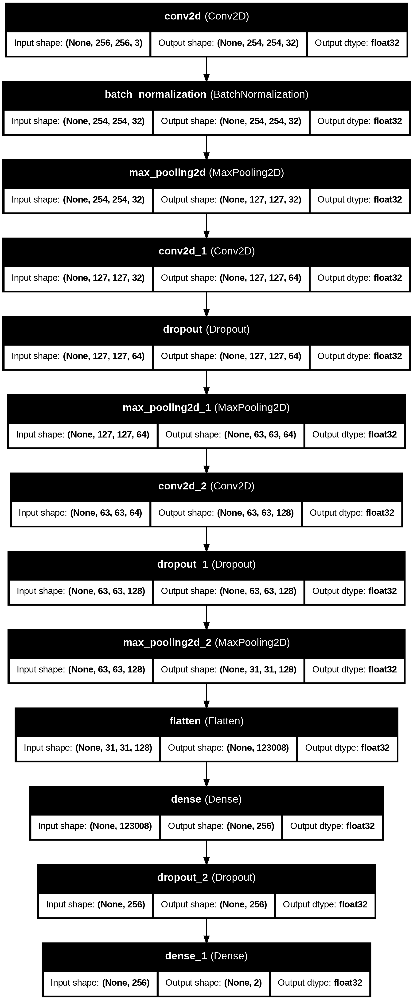

In [ ]:
plot_model(Model,to_file="Model_One.png",show_layer_names=True,show_dtype=True,show_shapes=True)

In [ ]:
Model_Results = Model.evaluate(Test_IMG_Set)
print("LOSS:  " + "%.4f" % Model_Results[0])
print("ACCURACY:  " + "%.2f" % Model_Results[1])

4/4 ━━━━━━━━━━━━━━━━━━━━ 10s 2s/step - accuracy: 0.8648 - loss: 0.2776
LOSS:  0.2707
ACCURACY:  0.86


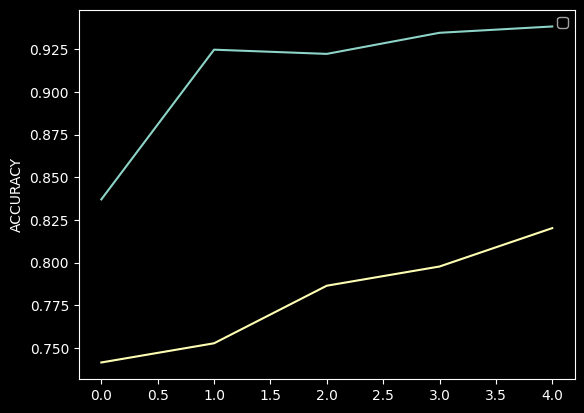

In [ ]:
plt.plot(CNN_Model.history["accuracy"])
plt.plot(CNN_Model.history["val_accuracy"])
plt.ylabel("ACCURACY")
plt.legend()
plt.show()

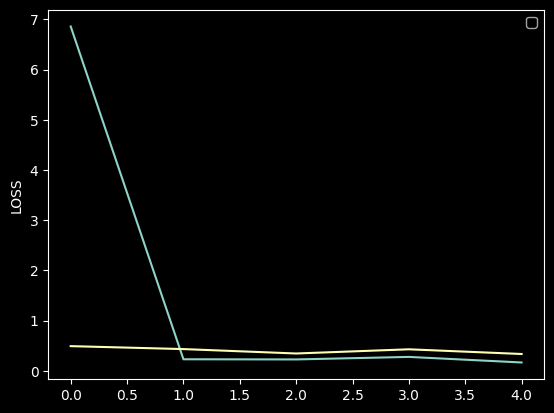

In [ ]:
plt.plot(CNN_Model.history["loss"])
plt.plot(CNN_Model.history["val_loss"])
plt.ylabel("LOSS")
plt.legend()
plt.show()

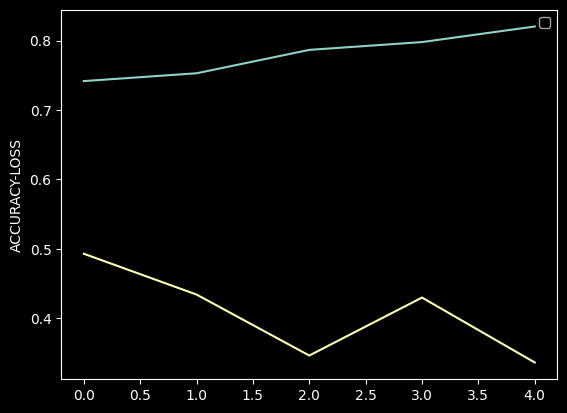

In [ ]:
plt.plot(CNN_Model.history["val_accuracy"])
plt.plot(CNN_Model.history["val_loss"])
plt.ylabel("ACCURACY-LOSS")
plt.legend()
plt.show()

<Axes: >

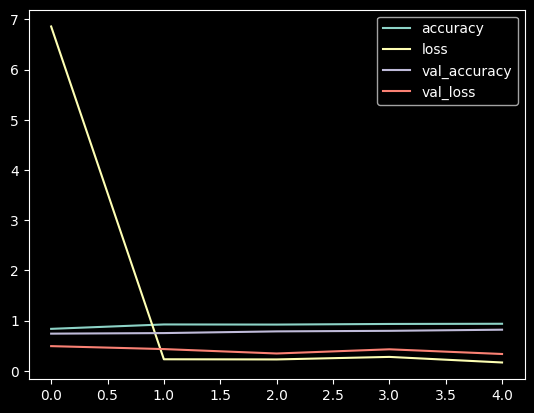

In [ ]:
Dict_Summary_One = pd.DataFrame(CNN_Model.history)
Dict_Summary_One.plot()

In [ ]:
Prediction_One = Model.predict(Test_IMG_Set)
Prediction_One = Prediction_One.argmax(axis=-1)

4/4 ━━━━━━━━━━━━━━━━━━━━ 4s 942ms/step


In [ ]:
print(Prediction_One)

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 1 0 0 1 0 0 1 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1]


In [ ]:
predictions = Model.predict(Test_IMG_Set)  # Get probabilities
Predict_Class = np.argmax(predictions, axis=1)


4/4 ━━━━━━━━━━━━━━━━━━━━ 4s 756ms/step


In [ ]:
print(Predict_Class)

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 1 0 0 0 0 1 1
 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0]


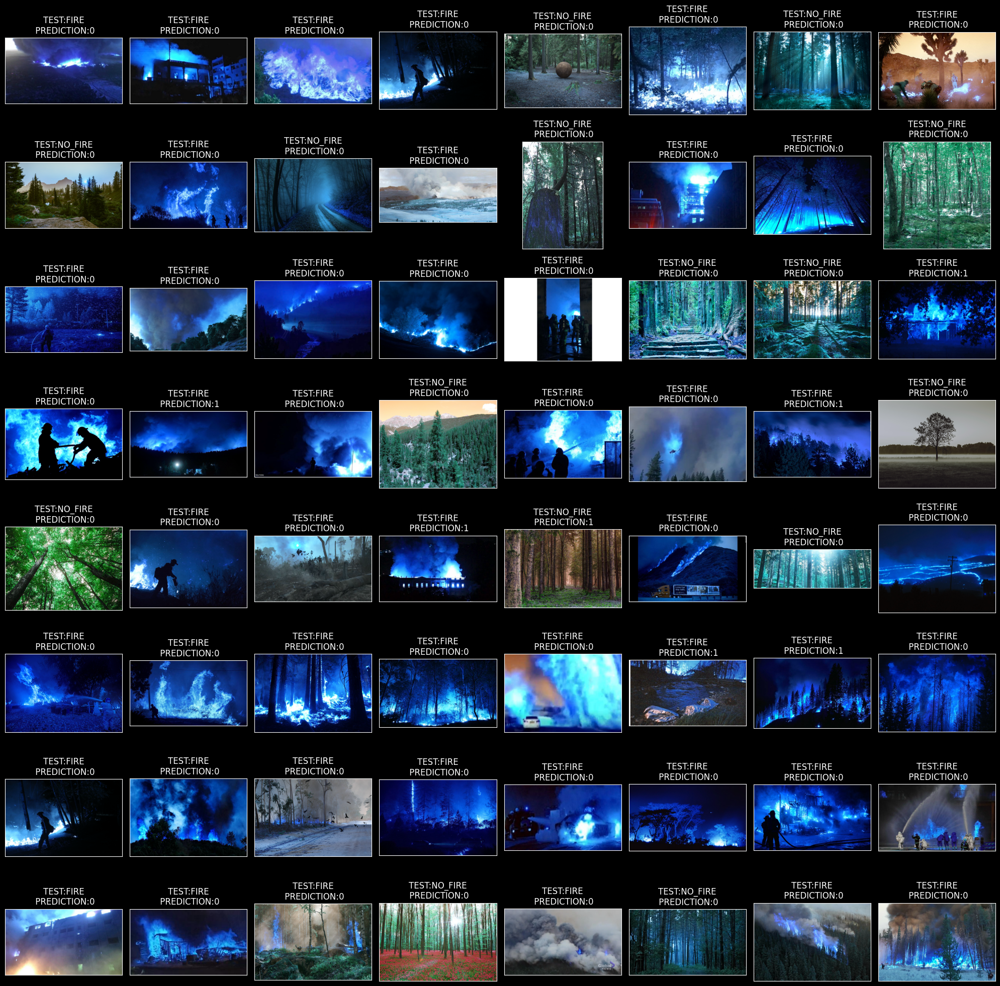

In [ ]:
fig, axes = plt.subplots(nrows=8,
                         ncols=8,
                         figsize=(20, 20),
                        subplot_kw={'xticks': [], 'yticks': []})

for i, ax in enumerate(axes.flat):
    ax.imshow(cv2.imread(Test_Data["PNG"].iloc[i]))
    ax.set_title(f"TEST:{Test_Data.CATEGORY.iloc[i]}\n PREDICTION:{Predict_Class[i]}")
plt.tight_layout()
plt.show()

In [ ]:
print(confusion_matrix(For_Prediction_Class,Predict_Class))

[[69  8]
 [22  1]]


In [ ]:
print(classification_report(For_Prediction_Class,Predict_Class))

              precision    recall  f1-score   support

           0       0.76      0.90      0.82        77
           1       0.11      0.04      0.06        23

    accuracy                           0.70       100
   macro avg       0.43      0.47      0.44       100
weighted avg       0.61      0.70      0.65       100



In [ ]:
image_path = "/content/testimage.jpeg"
img = image.load_img(image_path,target_size=(256,256))
x = image.img_to_array(img)
x = np.expand_dims(x,axis=0)

In [ ]:
Diff_Pred = Model.predict(x)
Diff_Pred = Diff_Pred.argmax(axis=-1)
print(Diff_Pred)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
[0]


In [ ]:
image_path_Two = "/content/nofire.jpg"
img_Two = image.load_img(image_path_Two,target_size=(256,256))
x_Two = image.img_to_array(img_Two)
x_Two = np.expand_dims(x_Two,axis=0)

In [ ]:
Diff_Pred_Two = Model.predict(x_Two)
Diff_Pred_Two = Diff_Pred_Two.argmax(axis=-1)
print(Diff_Pred_Two)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
[1]


In [ ]:
Model_Two = tf.keras.models.Sequential([
  # inputs
  tf.keras.layers.Rescaling(1./255),
  tf.keras.layers.Flatten(input_shape=(256,)),
  # hiddens layers
  tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dense(64, activation='relu'),
  tf.keras.layers.Dropout(0.2),
  # output layer
  tf.keras.layers.Dense(2,activation="softmax")
])

In [ ]:
Model_Two.compile(optimizer = 'adam' , loss = 'categorical_crossentropy' , metrics = ['accuracy'])

In [ ]:
ANN_Model = Model_Two.fit(Train_IMG_Set,
                          validation_data=Validation_IMG_Set,
                          callbacks=Call_Back,
                      epochs=5)

Epoch 1/5
26/26 ━━━━━━━━━━━━━━━━━━━━ 37s 1s/step - accuracy: 0.6914 - loss: 0.5417 - val_accuracy: 0.7865 - val_loss: 0.4127
Epoch 2/5
26/26 ━━━━━━━━━━━━━━━━━━━━ 31s 1s/step - accuracy: 0.8198 - loss: 0.3662 - val_accuracy: 0.8427 - val_loss: 0.3343
Epoch 3/5
26/26 ━━━━━━━━━━━━━━━━━━━━ 35s 1s/step - accuracy: 0.8330 - loss: 0.3328 - val_accuracy: 0.8989 - val_loss: 0.2957
Epoch 4/5
26/26 ━━━━━━━━━━━━━━━━━━━━ 37s 1s/step - accuracy: 0.8963 - loss: 0.2674 - val_accuracy: 0.8652 - val_loss: 0.3071
Epoch 5/5
26/26 ━━━━━━━━━━━━━━━━━━━━ 31s 1s/step - accuracy: 0.8859 - loss: 0.3124 - val_accuracy: 0.9101 - val_loss: 0.2266


In [ ]:
print(Model_Two.summary())

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ rescaling (Rescaling)                │ (None, 256, 256, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 196608)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 128)                 │      25,165,952 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 2)                   │             130 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 75,523,016 (288.10 MB)

 Trainable params: 25,174,338 (96.03 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 50,348,678 (192.06 MB)

None


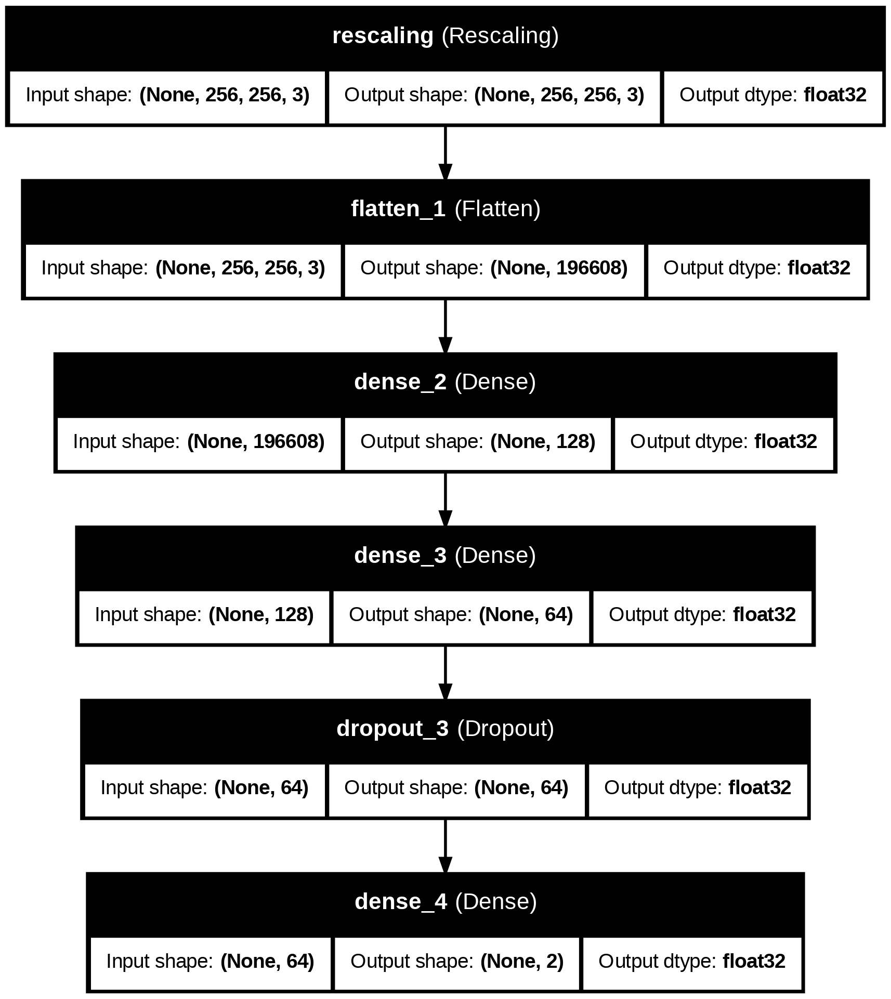

In [ ]:
plot_model(Model_Two,to_file="Model_Two.png",show_layer_names=True,show_dtype=True,show_shapes=True)

In [ ]:
Model_Results_Two = Model_Two.evaluate(Test_IMG_Set)
print("LOSS:  " + "%.4f" % Model_Results_Two[0])
print("ACCURACY:  " + "%.2f" % Model_Results_Two[1])

4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 380ms/step - accuracy: 0.8490 - loss: 0.3050
LOSS:  0.2746
ACCURACY:  0.87


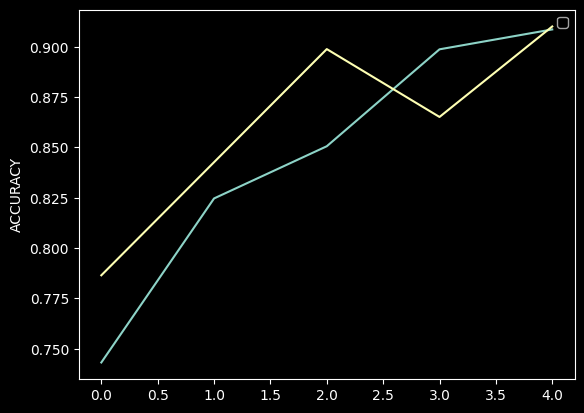

In [ ]:
plt.plot(ANN_Model.history["accuracy"])
plt.plot(ANN_Model.history["val_accuracy"])
plt.ylabel("ACCURACY")
plt.legend()
plt.show()

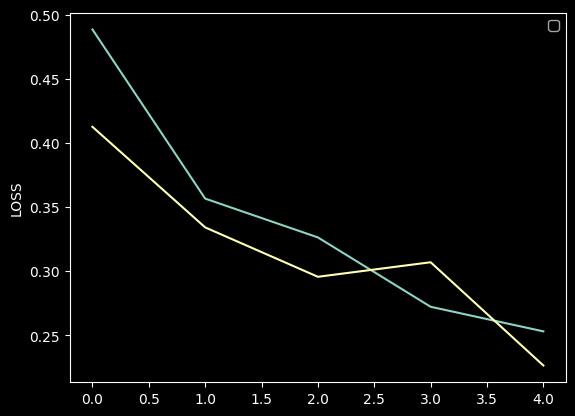

In [ ]:
plt.plot(ANN_Model.history["loss"])
plt.plot(ANN_Model.history["val_loss"])
plt.ylabel("LOSS")
plt.legend()
plt.show()

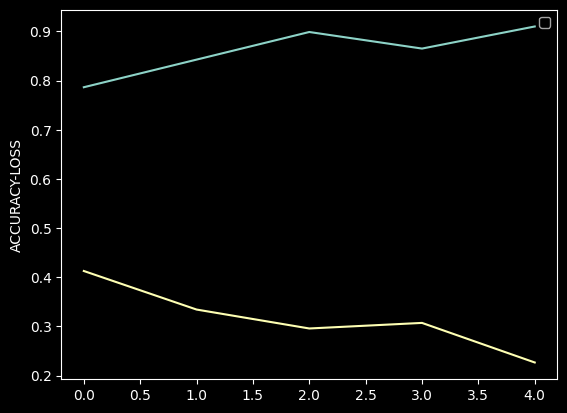

In [ ]:
plt.plot(ANN_Model.history["val_accuracy"])
plt.plot(ANN_Model.history["val_loss"])
plt.ylabel("ACCURACY-LOSS")
plt.legend()
plt.show()

<Axes: >

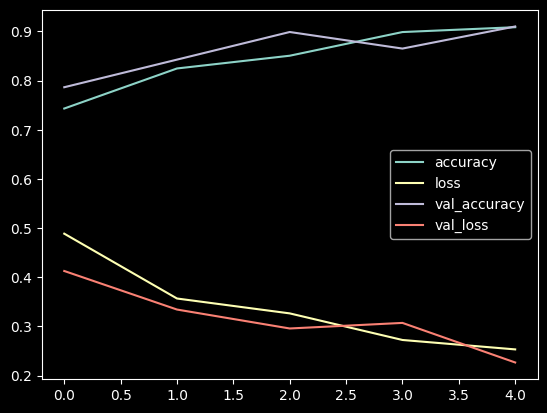

In [ ]:
Dict_Summary_Two = pd.DataFrame(ANN_Model.history)
Dict_Summary_Two.plot()

#### PREDICTION

In [ ]:
Prediction_Two = Model_Two.predict(Test_IMG_Set)
Prediction_Two = Prediction_Two.argmax(axis=-1)

4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 295ms/step


In [ ]:
print(Prediction_Two)

[0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0
 0 1 1 0 0 0 0 1 0 1 0 1 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 1 0 1 0 1 0 0 0 0 0
 0 1 0 1 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1]


In [ ]:
predictions = Model_Two.predict(Test_IMG_Set)  # Get probability distributions
Prediction_Class_Two = np.argmax(predictions, axis=1)

4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 430ms/step


In [ ]:
print(Prediction_Class_Two)

[0 0 0 0 0 1 0 0 0 0 0 0 1 0 1 0 0 0 0 0 1 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0
 1 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 1 0 0 1 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0
 0 0 0 1 0 0 0 1 0 0 0 0 1 1 0 0 1 0 0 0 0 0 1 0 0 1]


* {'FIRE': 0, 'NO_FIRE': 1}

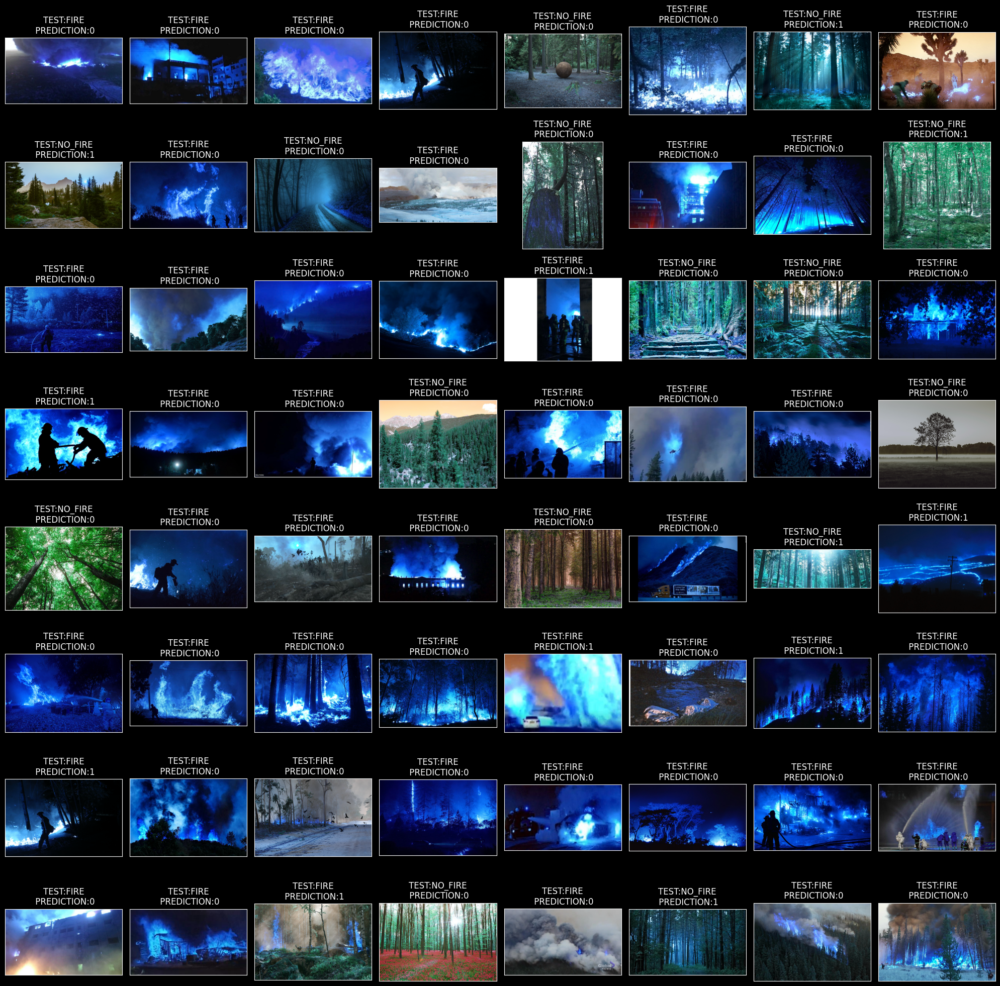

In [ ]:
fig, axes = plt.subplots(nrows=8,
                         ncols=8,
                         figsize=(20, 20),
                        subplot_kw={'xticks': [], 'yticks': []})

for i, ax in enumerate(axes.flat):
    ax.imshow(cv2.imread(Test_Data["PNG"].iloc[i]))
    ax.set_title(f"TEST:{Test_Data.CATEGORY.iloc[i]}\n PREDICTION:{Prediction_Two[i]}")
plt.tight_layout()
plt.show()

#### CLASSIFICATION & CONFUSION REPORT

In [ ]:
print(confusion_matrix(For_Prediction_Class,Prediction_Class_Two))

[[60 17]
 [20  3]]


In [ ]:
print(classification_report(For_Prediction_Class,Prediction_Class_Two))

              precision    recall  f1-score   support

           0       0.75      0.78      0.76        77
           1       0.15      0.13      0.14        23

    accuracy                           0.63       100
   macro avg       0.45      0.45      0.45       100
weighted avg       0.61      0.63      0.62       100



#### PREDICTION FOR ANOTHER SOURCE

* FIRE

In [ ]:
image_path = "/content/testimage.jpeg"
img = image.load_img(image_path,target_size=(256,256))
x = image.img_to_array(img)
x = np.expand_dims(x,axis=0)

In [ ]:
Diff_Pred = Model_Two.predict(x)
Diff_Pred = Diff_Pred.argmax(axis=-1)
print(Diff_Pred)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
[0]


* NOT FIRE

In [ ]:
image_path_Two = "/content/nofire.jpg"
img_Two = image.load_img(image_path_Two,target_size=(256,256))
x_Two = image.img_to_array(img_Two)
x_Two = np.expand_dims(x_Two,axis=0)

In [ ]:
Diff_Pred_Two = Model_Two.predict(x_Two)
Diff_Pred_Two = Diff_Pred_Two.argmax(axis=-1)
print(Diff_Pred_Two)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
[1]


# NAS


In [ ]:
from tensorflow.keras.layers import Reshape
base_model = NASNetMobile(weights='imagenet', include_top=False, input_shape=(256, 256, 3))

# Fine-tune last 150 layers (instead of 100)
for layer in base_model.layers[:-150]:
    layer.trainable = False
for layer in base_model.layers[-150:]:
    layer.trainable = True

# Build the NAS-Optimized CNN-RCNN Model
Model_Three = Sequential()

# Add NASNetMobile as Feature Extractor
Model_Three.add(base_model)
Model_Three.add(Flatten())  # Keeps full feature details instead of GlobalAveragePooling2D

# Ensure LSTM-GRU gets 3D input
Model_Three.add(Reshape((1, -1)))  # Converts (batch_size, features) → (batch_size, 1, features)

# LSTM + GRU Layers (Sequential Feature Learning)
Model_Three.add(Bidirectional(LSTM(128, return_sequences=True, dropout=0.2, recurrent_dropout=0.2)))
Model_Three.add(Bidirectional(GRU(128, return_sequences=True, dropout=0.2, recurrent_dropout=0.2)))

# Fully Connected Layers
Model_Three.add(Flatten())
Model_Three.add(Dense(512, activation="relu"))
Model_Three.add(Dropout(0.2))
Model_Three.add(Dense(256, activation="relu"))
Model_Three.add(Dropout(0.2))

# Output Layer
Model_Three.add(Dense(2, activation="softmax"))


In [ ]:
from tensorflow.keras.optimizers import Nadam
Model_Three.compile(
    optimizer=Nadam(learning_rate=0.0001),
    loss="categorical_crossentropy",
    metrics=["accuracy"]
)

In [ ]:
RCNN_Model = Model_Three.fit(Train_IMG_Set,
                          validation_data=Validation_IMG_Set,
                          callbacks=Call_Back,
                      epochs=50)

Epoch 1/50
26/26 ━━━━━━━━━━━━━━━━━━━━ 187s 5s/step - accuracy: 0.7766 - loss: 0.4967 - val_accuracy: 0.7753 - val_loss: 0.5799
Epoch 2/50
26/26 ━━━━━━━━━━━━━━━━━━━━ 114s 4s/step - accuracy: 0.9194 - loss: 0.2054 - val_accuracy: 0.8427 - val_loss: 0.6041
Epoch 3/50
26/26 ━━━━━━━━━━━━━━━━━━━━ 114s 4s/step - accuracy: 0.9616 - loss: 0.1184 - val_accuracy: 0.8427 - val_loss: 0.7258
Epoch 4/50
26/26 ━━━━━━━━━━━━━━━━━━━━ 116s 4s/step - accuracy: 0.9777 - loss: 0.0751 - val_accuracy: 0.7865 - val_loss: 0.9855
Epoch 5/50
26/26 ━━━━━━━━━━━━━━━━━━━━ 118s 5s/step - accuracy: 0.9787 - loss: 0.0706 - val_accuracy: 0.8539 - val_loss: 0.6053
Epoch 6/50
26/26 ━━━━━━━━━━━━━━━━━━━━ 114s 4s/step - accuracy: 0.9619 - loss: 0.1100 - val_accuracy: 0.8427 - val_loss: 0.5849
Epoch 7/50
26/26 ━━━━━━━━━━━━━━━━━━━━ 115s 4s/step - accuracy: 0.9840 - loss: 0.0509 - val_accuracy: 0.8764 - val_loss: 0.4310
Epoch 8/50
26/26 ━━━━━━━━━━━━━━━━━━━━ 141s 4s/step - accuracy: 0.9885 - loss: 0.0311 - val_accuracy: 0.8989 - v

In [ ]:
print(Model_Three.summary())

Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ nasnet_mobile (Functional)           │ (None, 8, 8, 1056)          │       4,269,716 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_6 (Flatten)                  │ (None, 67584)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape_1 (Reshape)                  │ (None, 1, 67584)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional_4 (Bidirectional)      │ (None, 1, 256)              │      69,338,112 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional_5 (Bidirectional)      │ (None, 1, 256)              │         296,448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_7 (Flatten)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_10 (Dense)                     │ (None, 512)                 │         131,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_8 (Dropout)                  │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_11 (Dense)                     │ (None, 256)                 │         131,328 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_9 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_12 (Dense)                     │ (None, 2)                   │             514 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 218,120,093 (832.06 MB)

 Trainable params: 71,976,194 (274.57 MB)

 Non-trainable params: 2,191,508 (8.36 MB)

 Optimizer params: 143,952,391 (549.13 MB)

None


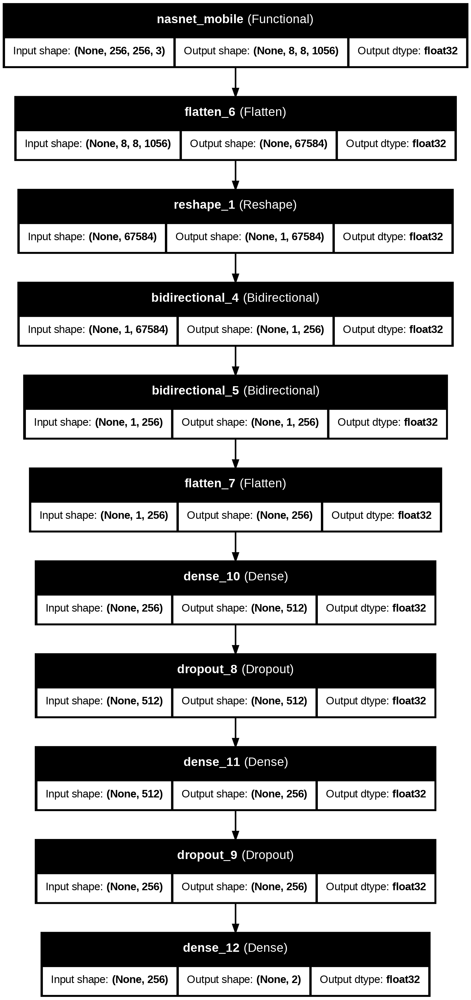

In [ ]:
plot_model(Model_Three,to_file="Model_Three.png",show_layer_names=True,show_dtype=True,show_shapes=True)

In [ ]:
Model_Results_Three = Model_Three.evaluate(Test_IMG_Set)
print("LOSS:  " + "%.4f" % Model_Results_Three[0])
print("ACCURACY:  " + "%.2f" % Model_Results_Three[1])

4/4 ━━━━━━━━━━━━━━━━━━━━ 8s 2s/step - accuracy: 0.8954 - loss: 0.3890
LOSS:  0.4040
ACCURACY:  0.90


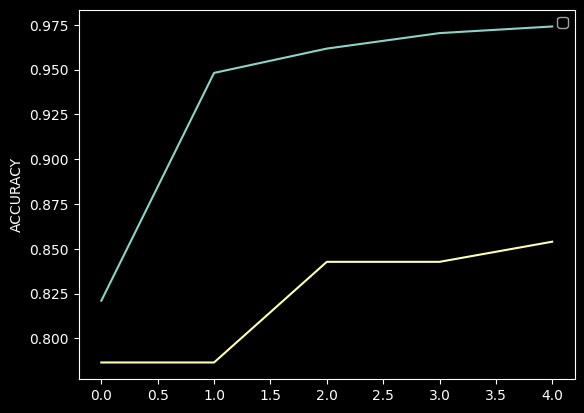

In [ ]:
plt.plot(RCNN_Model.history["accuracy"])
plt.plot(RCNN_Model.history["val_accuracy"])
plt.ylabel("ACCURACY")
plt.legend()
plt.show()

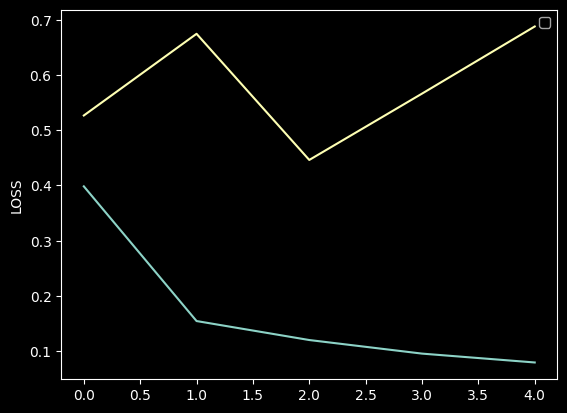

In [ ]:
plt.plot(RCNN_Model.history["loss"])
plt.plot(RCNN_Model.history["val_loss"])
plt.ylabel("LOSS")
plt.legend()
plt.show()

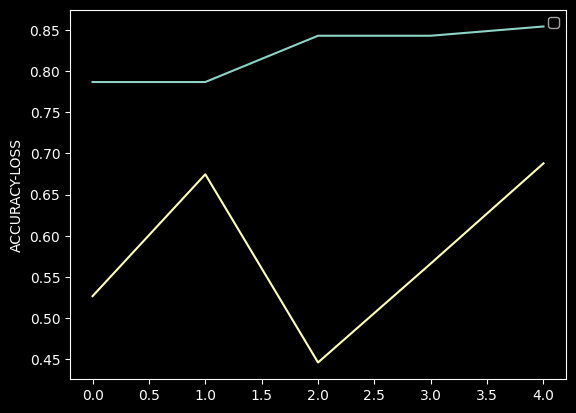

In [ ]:
plt.plot(RCNN_Model.history["val_accuracy"])
plt.plot(RCNN_Model.history["val_loss"])
plt.ylabel("ACCURACY-LOSS")
plt.legend()
plt.show()

<Axes: >

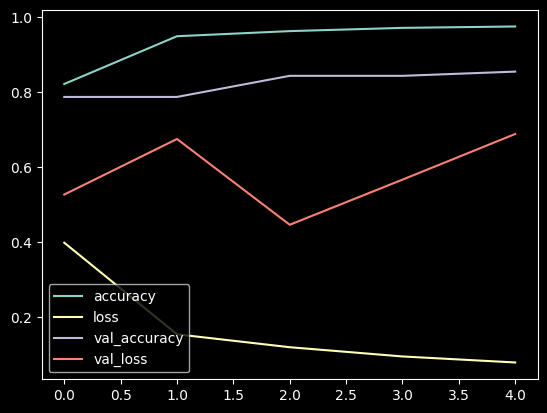

In [ ]:
Dict_Summary_Three = pd.DataFrame(RCNN_Model.history)
Dict_Summary_Three.plot()

In [ ]:
Prediction_Three = Model_Three.predict(Test_IMG_Set)
Prediction_Three = Prediction_Three.argmax(axis=-1)

4/4 ━━━━━━━━━━━━━━━━━━━━ 21s 4s/step


In [ ]:
print(Prediction_Three)

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0
 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


* {'FIRE': 0, 'NO_FIRE': 1}

In [ ]:
predictions = Model_Three.predict(Test_IMG_Set)  # Get probability distributions
Prediction_Class_Three = np.argmax(predictions, axis=1)

4/4 ━━━━━━━━━━━━━━━━━━━━ 8s 2s/step


In [ ]:
print(Prediction_Class_Three)

[0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0]


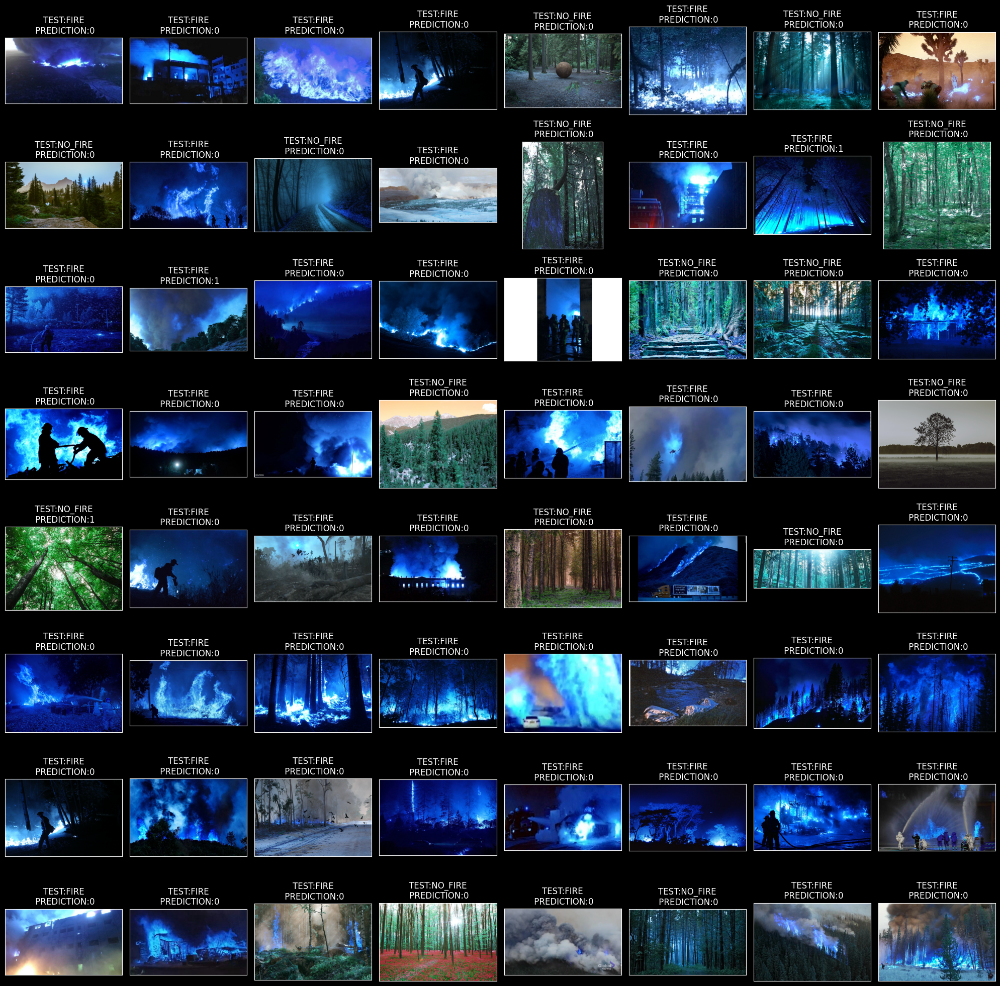

In [ ]:
fig, axes = plt.subplots(nrows=8,
                         ncols=8,
                         figsize=(20, 20),
                        subplot_kw={'xticks': [], 'yticks': []})

for i, ax in enumerate(axes.flat):
    ax.imshow(cv2.imread(Test_Data["PNG"].iloc[i]))
    ax.set_title(f"TEST:{Test_Data.CATEGORY.iloc[i]}\n PREDICTION:{Prediction_Three[i]}")
plt.tight_layout()
plt.show()

#### CLASSIFICATION & CONFUSION REPORT

In [ ]:
print(classification_report(For_Prediction_Class,Prediction_Three))

              precision    recall  f1-score   support

           0       0.78      0.95      0.85        77
           1       0.33      0.09      0.14        23

    accuracy                           0.75       100
   macro avg       0.55      0.52      0.50       100
weighted avg       0.67      0.75      0.69       100



In [ ]:
print(confusion_matrix(For_Prediction_Class,Prediction_Three))

[[73  4]
 [21  2]]


##### PREDICTION FOR DIFFERENT SOURCE

* FIRE

In [ ]:
image_path = "/content/testimage.jpeg"
img = image.load_img(image_path,target_size=(256,256))
x = image.img_to_array(img)
x = np.expand_dims(x,axis=0)

In [ ]:
Diff_Pred = Model_Three.predict(x)
Diff_Pred = Diff_Pred.argmax(axis=-1)
print(Diff_Pred)

1/1 ━━━━━━━━━━━━━━━━━━━━ 7s 7s/step
[0]


[0]

* NOT FIRE

In [ ]:
image_path_Two = "/content/nofire.jpg"
img_Two = image.load_img(image_path_Two,target_size=(256,256))
x_Two = image.img_to_array(img_Two)
x_Two = np.expand_dims(x_Two,axis=0)

In [ ]:
Diff_Pred_Three = Model_Three.predict(x)
Diff_Pred_Three = Diff_Pred_Three.argmax(axis=-1)
print(Diff_Pred_Three)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
[0]


[1]